# Coral-Sol

This notebook models the advection of Tubastrae larvae

Before executing this notebook make sure you follow the steps here to retrieve and regrid the data.

Firstly, we load the necessary libraries.

In [1]:
# Clean environment
import warnings
# warnings.filterwarnings('ignore')

# Required packages
import os
from datetime import timedelta
import numpy as np
import math
from operator import attrgetter

# Parcels
from parcels import FieldSet, ParticleSet, JITParticle, ErrorCode, Variable
from parcels import AdvectionRK4
from parcels import rng as pRandom

from plotting import plotTrajectories

# This is needed to display graphics calculated outside of jupyter notebook
from IPython.display import display
from IPython.display import Image
from IPython.display import Markdown as md

# Widgets
import ipywidgets as widgets

gridWidget = widgets.Dropdown(
    options=['9km', '3km', '1km', '500m'],
    value='1km',
    #rows=10,
    description='Grid Size',
    disabled=False
)
nLarvaeWidget = widgets.Dropdown(
    options=[5, 10, 25, 50, 100, 250, 500, 1000],
    value=5,
    description='Num Larvae',
    disabled=False
)
releaseWidget = widgets.IntSlider(
    value=30,
    min=30,
    max=240,
    step=30,
    description='Release (minutes)',
    orientation='horizontal',
    disabled=False
)

def select_n_larvae(selected_n_larvae):
    global nLarvae
    nLarvae = selected_n_larvae
    
def select_release(selected_release):
    global release
    release = selected_release
    
def select_grid(selected_grid):
    global grid
    grid = selected_grid
    os.environ["grid"] = grid
        
widgets.interact(select_grid, selected_grid=gridWidget);
widgets.interact(select_n_larvae, selected_n_larvae=nLarvaeWidget);
widgets.interact(select_release, selected_release=releaseWidget);

year = 2017

interactive(children=(Dropdown(description='Grid Size', index=2, options=('9km', '3km', '1km', '500m'), value=…

interactive(children=(Dropdown(description='Num Larvae', options=(5, 10, 25, 50, 100, 250, 500, 1000), value=5…

interactive(children=(IntSlider(value=30, description='Release (minutes)', max=240, min=30, step=30), Output()…

## Reading in data from arbritrary NetCDF files

In most cases, you will want to advect particles within pre-computed velocity fields. If these velocity fields are stored in NetCDF format, it is fairly easy to load them into the FieldSet.from_netcdf() function.

Define the names of the files containing the zonal (U), meridional (V) velocities and temperature. You can use wildcards (*) and the filenames for U and V can be the same (not in this case).

In [15]:
filenames = {
    'U': "/data/regrids/grid_{0}_u0-{1}.nc".format(grid, year),
    'V': "/data/regrids/grid_{0}_v0-{1}.nc".format(grid, year),
    'T': "/data/regrids/grid_{0}_temp-{1}.nc".format(grid, year),
    'Land': "/data/border_lines_gshhs_low_all.nc"
}
print(filenames)

{'U': '/data/regrids/grid_500m_u0-2017.nc', 'V': '/data/regrids/grid_500m_v0-2017.nc', 'T': '/data/regrids/grid_500m_temp-2017.nc', 'Land': '/data/border_lines_gshhs_low_all.nc'}


Then, define a dictionary of the variables (U and V) and dimensions (lon, lat and time; note that in this case there is no depth because the GlobCurrent data is only for the surface of the ocean)

In [16]:
variables = {
    'U': 'uo',
    'V': 'vo',
    'T': 'thetao',
    'Land': 'landsea_mask'
}
dimensions = {}
dimensions['U'] = {'lat': 'latitude', 'lon': 'longitude', 'depth': 'depth', 'time': 'time'}
dimensions['V'] = {'lat': 'latitude', 'lon': 'longitude', 'depth': 'depth', 'time': 'time'}
dimensions['T'] = {'lat': 'latitude', 'lon': 'longitude', 'depth': 'depth', 'time': 'time'}
dimensions['Land'] = {'lat': 'latitude', 'lon': 'longitude', 'time': 'time'}

In [17]:
# from netCDF4 import Dataset
# nc_file_src = '/data/regrids/grid_500m_temp-2017.nc'
# nc_file_dst = '/data/border_lines_gshhs_low.nc'
# toinclude = ["time"]
# with Dataset(nc_file_src) as src, Dataset(nc_file_dst, "r+") as dst:
#     print(src.dimensions)
#     # copy attributes
#     for name in src.ncattrs():
#         if name in toinclude:
#             dst.setncattr(name, src.getncattr(name))
#     # copy dimensions
#     for name, dimension in src.dimensions.items():
#         if name in toinclude:
#             dst.createDimension(name, len(dimension))
#     # copy all file data except for the excluded
#     for name, variable in src.variables.items():
#         if name in toinclude:
#             x = dst.createVariable(name, variable.datatype, variable.dimensions)
#             # Copy variable attributes
#             x.setncatts({k: variable.getncattr(k) for k in variable.ncattrs()})
# #             dst.variables[name][:] = src.variables[name][:]

#     dst.renameDimension(u'lon',u'longitude')
#     dst.renameVariable(u'lon',u'longitude')
#     dst.renameDimension(u'lat',u'latitude')
#     dst.renameVariable(u'lat',u'latitude')

In [18]:
# from netCDF4 import Dataset
# nc_fid = Dataset(nc_file_dst, 'r+')
# landsea_mask = nc_fid.createVariable('landsea_mask', np.int32, ('time', 'latitude', 'longitude'))
# landsea_mask[0] = nc_fid.variables['mask_array'][:]
# nc_fid.close()

# landsea_mask.setncatts({k: rocky_length.getncattr(k) for k in rocky_length.ncattrs()})
# nc_fid.variables


# # var_rl
# # rocky_len = nc_fid.createVariable('rocky_len', np.float32, ('time', 'depth', 'latitude', 'longitude'))
# # times = nc_fid.variables['time'][:]
# # depths = nc_fid.variables['depth'][:]
# # for time in range(0,len(times)):
# #     for depth in range(0,len(depths)):
# #         rocky_len[time, depth,:,:] = var_rl
# # var_new_rl = nc_fid.variables['rocky_len'][:]
# # var_new_rl


In [19]:
# from netCDF4 import Dataset
# nc_file = '/data/rocky_leng.nc'
# nc_fid = Dataset(nc_file, 'r')
# var_rl = nc_fid.variables['rocky_length']
# var_rl

In [20]:
# from netCDF4 import Dataset
# nc_fid = Dataset(nc_file_dst, 'r')
# nc_fid.variables['landsea_mask'][:]

Finally, read in the fieldset using the FieldSet.from_netcdf function with the above-defined filenames, variables and dimensions

In [21]:
fieldset = FieldSet.from_netcdf(filenames, variables, dimensions)

In [22]:
npart = nLarvae  # number of particles to be released
lon = -48.371884 * np.ones(npart)
lat = -27.2843332 * np.ones(npart)
time = np.arange(0, npart) * timedelta(minutes=release).total_seconds()  # release every particle one hour later

class Larvae(JITParticle):         # Define a new particle class
    temp = Variable('temp', initial=0)  # Variable 'temperature' initialised by sampling the temperature
    land = Variable('land', initial=0)  # Variable 'land' initialised by sampling the landsea mask
#     rocky = Variable('rocky', initial=0)  # Variable 'temperature' initialised by sampling the temperature
    distance = Variable('distance', initial=0., dtype=np.float32)  # the distance travelled
    prev_lon = Variable('prev_lon', dtype=np.float32, to_write=False,
                        initial=attrgetter('lon'))  # the previous longitude
    prev_lat = Variable('prev_lat', dtype=np.float32, to_write=False,
                        initial=attrgetter('lat'))  # the previous latitude.

pset = ParticleSet(fieldset=fieldset, pclass=Larvae, lon=lon, lat=lat, time=time)
# pset = ParticleSet(fieldset=fieldset, pclass=Larvae, lon=lon, lat=lat, size=npart)

## Kernels

Now we want to advect the particles. However, the Globcurrent data that we loaded in is only for a limited, regional domain and particles might be able to leave this domain. We therefore need to tell Parcels that particles that leave the domain need to be deleted. We do that using a Recovery Kernel, which will be invoked when a particle encounters an ErrorOutOfBounds error:

In [23]:
def DeleteParticle(particle, fieldset, time):
    particle.delete()

In [24]:
def RandomDeath(particle, fieldset, time):
    if ParcelsRandom.randint(1, 299) == 1:
        particle.delete()
        
k_random_death = pset.Kernel(RandomDeath)

In [25]:
def SlowDown(particle, fieldset, time):
    particle.lon -= 0.0004
    particle.lat -= 0.0004
    
k_slow_down = pset.Kernel(SlowDown)

In [26]:
def RandomMovement(particle, fieldset, time):
    if ParcelsRandom.randint(1, 49) == 1:
        particle.lon -= 0.001
    if ParcelsRandom.randint(1, 49) == 1:
        particle.lat -= 0.001
    if ParcelsRandom.randint(1, 49) == 1:
        particle.lon += 0.001
    if ParcelsRandom.randint(1, 49) == 1:
        particle.lat += 0.001
    
k_random_movement = pset.Kernel(RandomMovement)

In [27]:
def SampleTemp(particle, fieldset, time):  # Custom function that samples fieldset.T at particle location
    particle.temp = fieldset.T[time, particle.depth, particle.lat, particle.lon]
    
k_sample_temp = pset.Kernel(SampleTemp)

In [28]:
# def SampleRockyLength(particle, fieldset, time):  # Custom function that samples fieldset.T at particle location
#     particle.rocky = fieldset.C[time, particle.depth, particle.lat, particle.lon]
    
# k_sample_rocky = pset.Kernel(SampleRockyLength)

In [29]:
def TotalDistance(particle, fieldset, time):
    # Calculate the distance in latitudinal direction (using 1.11e2 kilometer per degree latitude)
    lat_dist = (particle.lat - particle.prev_lat) * 1.11e2
    # Calculate the distance in longitudinal direction, using cosine(latitude) - spherical earth
    lon_dist = (particle.lon - particle.prev_lon) * 1.11e2 * math.cos(particle.lat * math.pi / 180)
    # Calculate the total Euclidean distance travelled by the particle
    particle.distance += math.sqrt(math.pow(lon_dist, 2) + math.pow(lat_dist, 2))

    particle.prev_lon = particle.lon  # Set the stored values for next iteration.
    particle.prev_lat = particle.lat
    
k_total_distance = pset.Kernel(TotalDistance)

In [30]:
def Suitability(particle, fieldset, time):
    particle.land = fieldset.Land[0, 0, particle.lat, particle.lon]
    print("Id: %s | Time: %s | Land: %s" % (particle.id, particle.time, particle.land))
    if particle.land == 1 and time > 3600:
        print("Deleting...")
        particle.delete()
        
k_suitability = pset.Kernel(Suitability)

In [31]:
# def Assentamento(particle, fieldset, time):
#     if particle.suitability > 0.5:
#         80% de chance
#     elif > 0.75:
#         100%
        
# k_random_death = pset.Kernel(RandomDeath)

In [39]:
output_file_name = "Trajectories4.nc"
output_file = pset.ParticleFile(name=output_file_name, outputdt=timedelta(hours=1))

pset.execute(
        AdvectionRK4,
        runtime=timedelta(hours=48),
        dt=timedelta(minutes=5),
        output_file=output_file,
        recovery={ErrorCode.ErrorOutOfBounds: DeleteParticle}
    )
output_file.close()

# for cnt in range(4):
#     # First plot the particles
#     pset.show(
#         savefile='/data/images/grid_{0}_particles{1}'.format(grid, str(cnt).zfill(2)),
# #         field='vector',
#         field=fieldset.C,
#         land=True,
#         vmin=0,
#         vmax=3000,
#         domain={'N':-27.01, 'S':-27.75, 'E':-48.2, 'W':-48.7}
#     )
#     pset.execute(
#         AdvectionRK4 + k_random_death + k_slow_down + k_random_movement + k_sample_temp + k_total_distance,
#         runtime=timedelta(hours=3),
#         dt=timedelta(minutes=5),
#         recovery={ErrorCode.ErrorOutOfBounds: DeleteParticle}
#     )
#     print('Length of pset at time %d: %d' % (cnt, len(pset)))

INFO: Compiled LarvaeAdvectionRK4 ==> /tmp/parcels-0/e4bab2061211207e1a9cfa2e354841e5_0.so


In [40]:
import xarray as xr
output_file_name = "Trajectories4.nc"
data_xarray = xr.open_dataset(output_file_name)
print(data_xarray['trajectory'])

<xarray.DataArray 'trajectory' (traj: 5, obs: 49)>
array([[ 5.,  5.,  5., ...,  5.,  5.,  5.],
       [ 6.,  6.,  6., ...,  6.,  6., nan],
       [ 7.,  7.,  7., ...,  7.,  7., nan],
       [ 8.,  8.,  8., ...,  8., nan, nan],
       [ 9.,  9.,  9., ...,  9., nan, nan]])
Dimensions without coordinates: traj, obs
Attributes:
    long_name:  Unique identifier for each particle
    cf_role:    trajectory_id


/opt/conda/lib/python3.6/site-packages/cartopy/mpl/geoaxes.py:388: MatplotlibDeprecationWarning: 
The 'inframe' parameter of draw() was deprecated in Matplotlib 3.3 and will be removed two minor releases later. Use Axes.redraw_in_frame() instead. If any parameter follows 'inframe', they should be passed as keyword, not positionally.
  inframe=inframe)


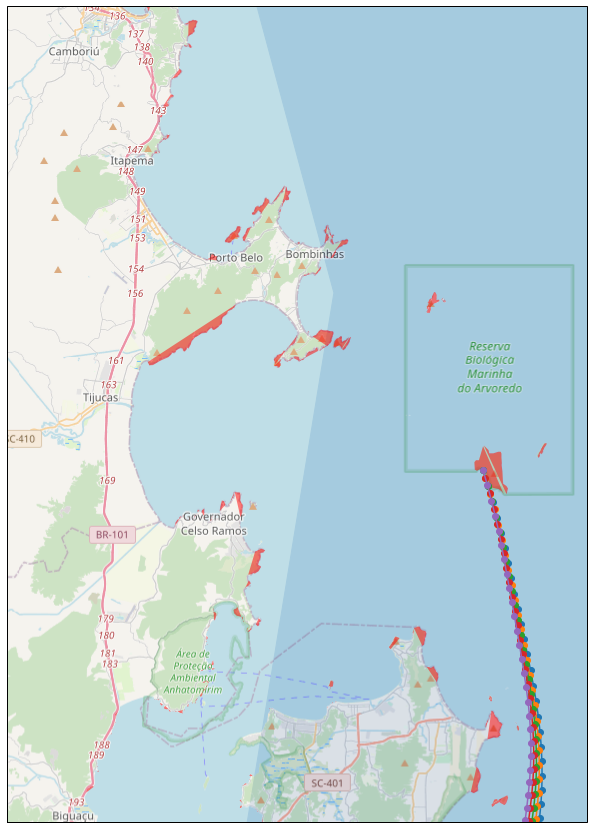

In [41]:
# domain = [-49, -48, -28, -27]
domain = [-48.7, -48.3, -27.5, -27]
costao_file = "/data/shapefiles/costao_PReSC.shp"
plotTrajectories(domain, data=data_xarray, shape_file=costao_file)

In [23]:
%env FILES=/data/images/grid_{grid}_*.png

env: FILES=/data/images/grid_1km_*.png


In [24]:
!convert $FILES "/data/images/animation_grid_${grid}.gif"

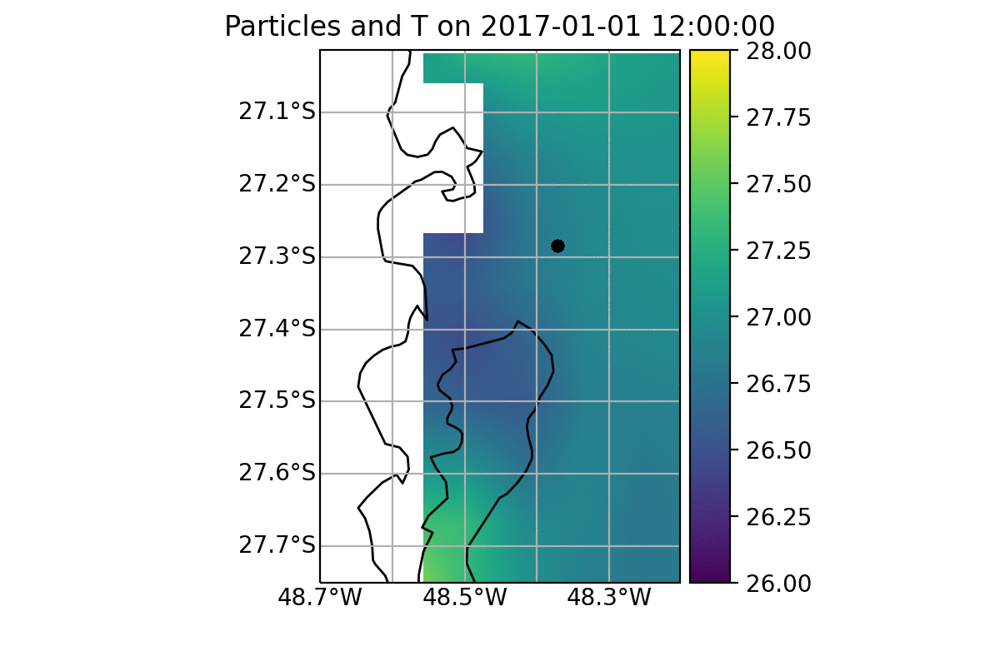

In [169]:
Image(filename="/data/images/animation_grid_{0}.gif".format(grid))

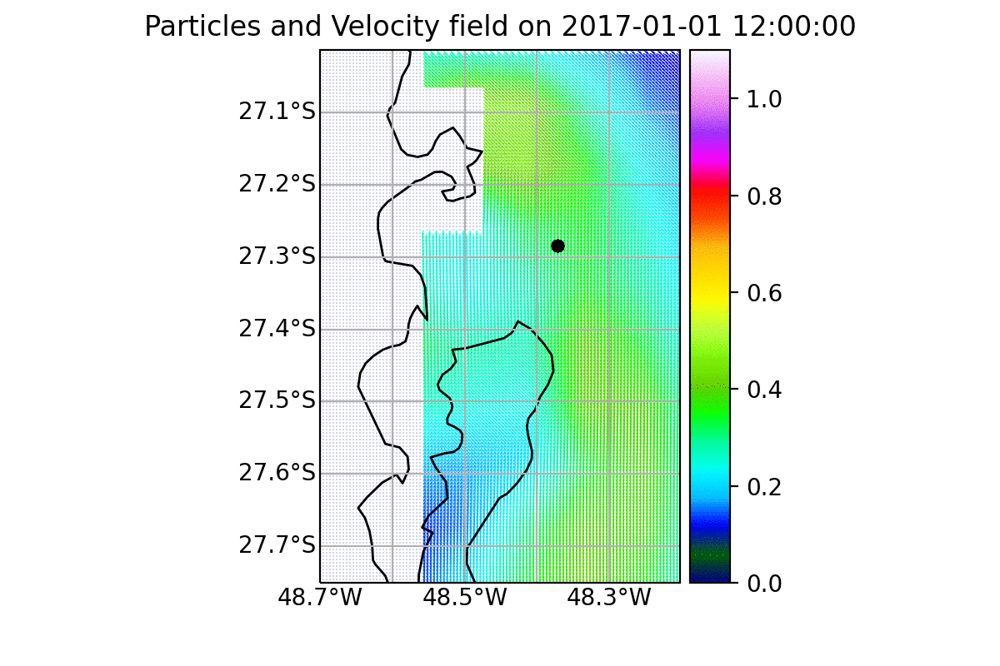

In [10]:
Image(filename="/data/images/animation_grid_500m_orig.gif".format(grid))

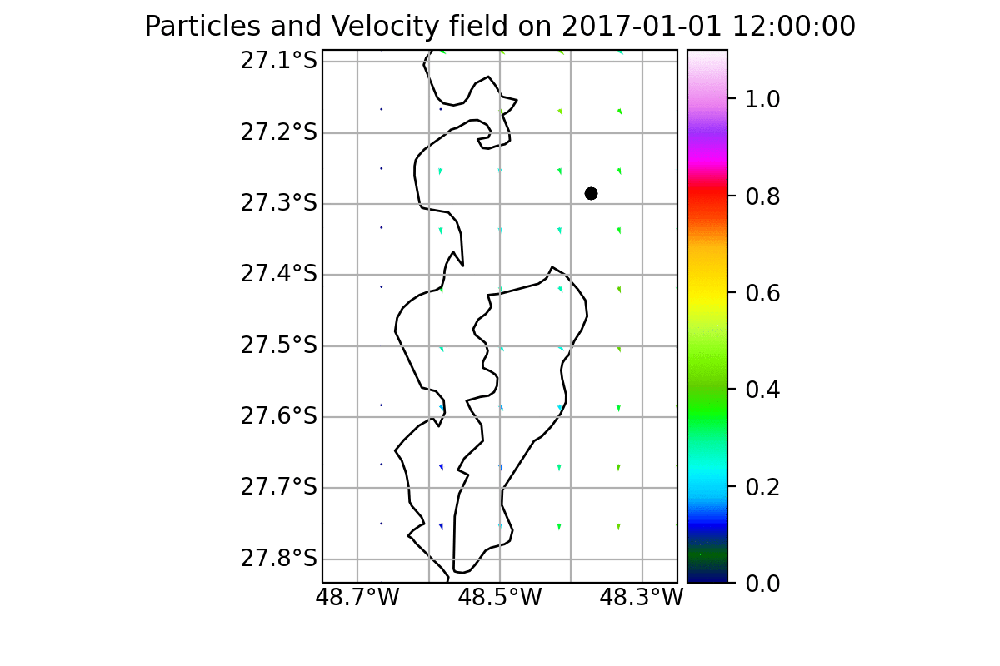

In [194]:
Image(filename="/data/images/pre_animation_grid_9km_10_90.gif")

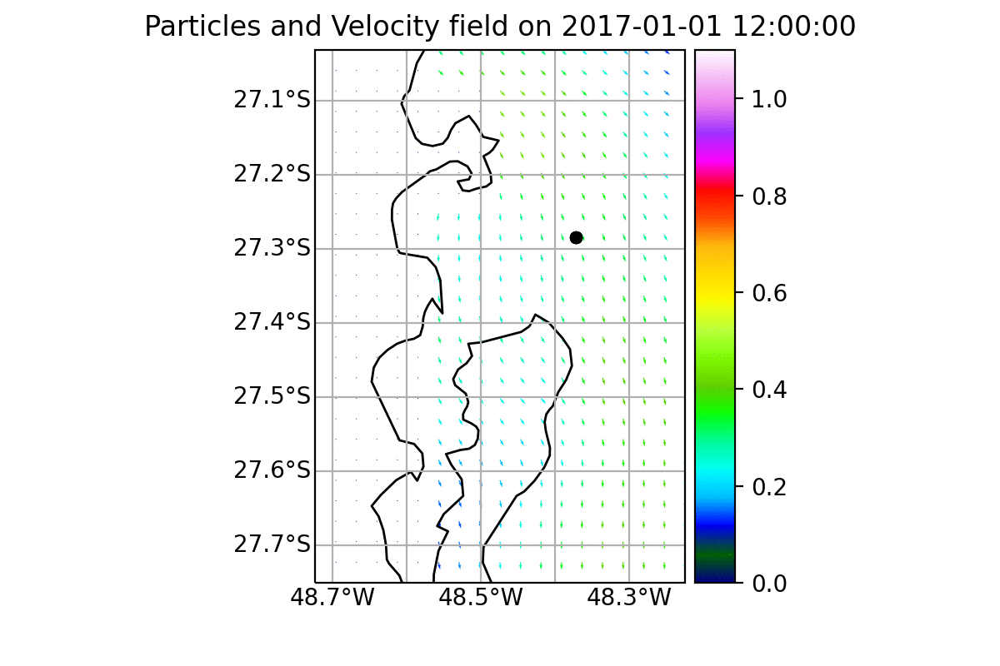

In [195]:
Image(filename="/data/images/pre_animation_grid_3km_10_90.gif")

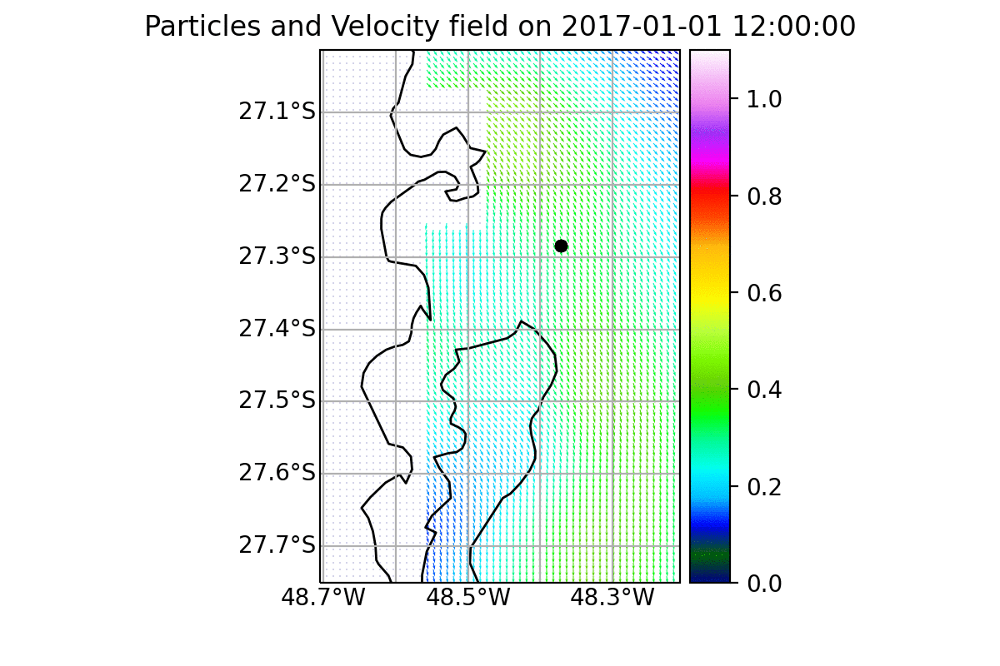

In [196]:
Image(filename="/data/images/pre_animation_grid_1km_10_90.gif")

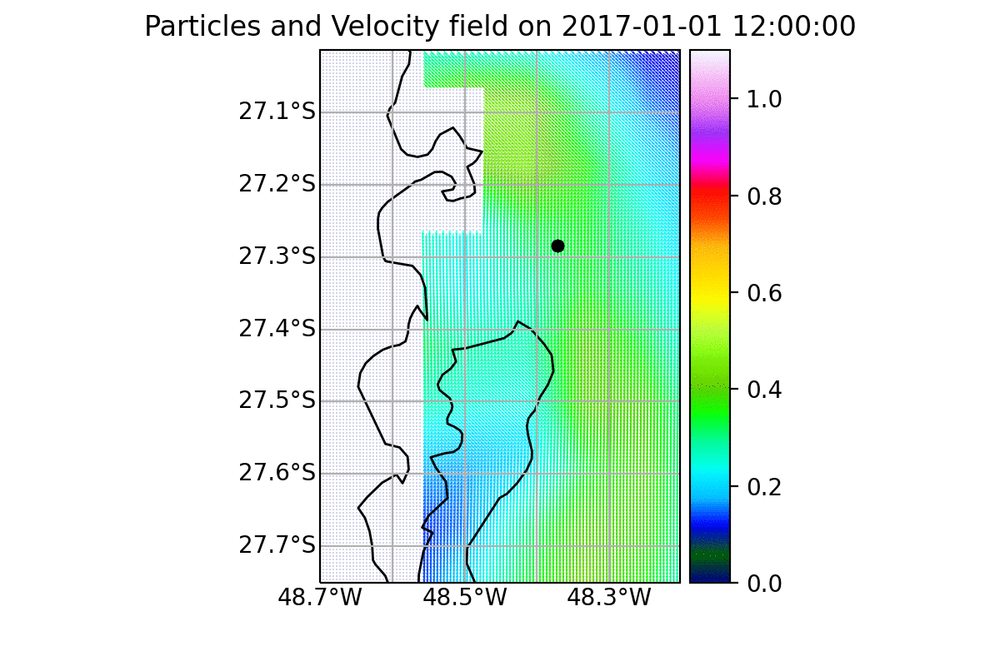

In [197]:
Image(filename="/data/images/pre_animation_grid_500m_10_90.gif")

In [ ]:
#output_file.export()
#plotTrajectoriesFile(output_file_name
#     tracerfile='/data/regrids/grid_3km_u0-2017.nc',
#     tracerlon='longitude',
#     tracerlat='latitude',
#     tracerfield='uo'
#);

In [ ]:
import gc
gc.collect()